In [45]:
# -*- coding: utf-8 -*-
import pandas as pd
import numpy as np
import seaborn as sns
import os, re, math
import matplotlib.pyplot as plt
from sklearn.metrics import mutual_info_score
from scipy.spatial.distance import jensenshannon
#%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

In [46]:
def mkdirs(dir_paths):
    for dir_path in dir_paths:
        if not os.path.exists(dir_path):
            os.makedirs(dir_path)

In [47]:
DATA_SET_DIR = '/Users/emmanueldollinger/PycharmProjects/prediction_by_k/DATA/Filtered_Feature_Analysis/'
ChrmoHMM_LABELS="Active Promoter","Weak Promoter","Poised Promoter","Strong Enhancer","Strong Enhancer","Weak Enhancer","Weak Enhancer","Insulator","Txn Transition","Txn Elongation","Weak Txn","Repressed","Heterochrom/lo","Repetitive/CNV","Repetitive/CNV"
NUMBER_OF_CHRMM_CLASS = len(ChrmoHMM_LABELS)
FILE_NAME_DICT={1: "METHY_K_LESS", 2: "METHY_K_INTER", 3: "METHY_K_GREATER"}
FILE_NAME_LABEL={1: "0< m <0.4", 2: "0.4< m <0.8", 3: "m>0.8"}
EACH_SUB_FIG_SIZE = 5
CHROMOSOMES = [i for i in range(1, 23)]

In [5]:
LOG_SCALE = False
JSD = True # Using JSD or Mutual information
HISTOGRAM = False # plot histogram or the distribution by pdf
MI_BIN = 10
N_CLASSES = 5
NBIN=20 if LOG_SCALE else 20
METRIC ="JSD" if JSD else "1-MI"

In [93]:
def get_percentile_index_arr(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX):
    df = pd.read_csv(DATA_FP, sep='\t', header=None).values
    ks = df[:, COL_INDEX]
    if K_analyze:
        if LOG_SCALE:
            ks[ks <= 0] = 0.001
            ks = np.log10(ks)
            df[:, COL_INDEX] = ks
            percentiles = [-2.0]
        else:
            percentiles = [0.0]
    else:
        if METHY_K_LESS == 1:
            percentiles = [0.0]
        elif METHY_K_LESS == 2:
            percentiles = [0.4]
        else:
            percentiles = [0.8]

    percentiles_to_query = np.array([i * 20 for i in range(1, N_CLASSES + 1)]) if K_analyze else np.array(
        [50, 65, 100])
    percentiles_results = list(np.percentile(ks, percentiles_to_query))
    for item in percentiles_results:
        percentiles.append(float(item))
    print(percentiles)
    df_indexs_arr = []
    for p_idx in range(len(percentiles) - 1):
        df_indexs = np.logical_and(ks > percentiles[p_idx], ks < percentiles[p_idx + 1])
        df_indexs_arr.append(df_indexs)
    return df_indexs_arr, df, percentiles

In [94]:
def hist_K_with_5_percentiles(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX, FIG_DIR):
    fig_dir = os.path.join(FIG_DIR, "Others")
    mkdirs([fig_dir])
    df_indexs_arr, df, percentiles = get_percentile_index_arr(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX)
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    Ks = df[:, COL_INDEX]
    xhist, _, _ = ax.hist(Ks, 20, density=True, facecolor='b', alpha=0.75)
    pK = xhist / xhist.sum()
    entropy = -np.sum(pK * np.log10(pK))
    for percentile in percentiles:
        ax.axvline(x=percentile, color='r')
    if K_analyze:
        if LOG_SCALE:
            xlabel = 'log10(k)'
            xlim = [-1, 1]
        else:
            xlabel = 'k'
            xlim = [0, 10]
    else:
        xlabel = 'methylation'
        if METHY_K_LESS == 1:
            xlim = [0, 0.4]
        elif METHY_K_LESS == 2:
            xlim = [0.4, 0.8]
        else:
            xlim = [0.8, 1]
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Probability')
    ax.set_title("Histogram of %s, Entropy: %.2f" % (xlabel, entropy))
    ax.set_xlim(xlim)
    plt.savefig(os.path.join(fig_dir, "Hist.png"), dpi=200)

In [83]:
def PREPARE_FIG_DIR(FIGURE_DIR, K_analyze):
    if K_analyze:
        if LOG_SCALE:
            sub_fig_dir = "K_Log10"
        else:
            sub_fig_dir = "K"
    else:
        sub_fig_dir = "Methy"
    print(sub_fig_dir + "_" + METRIC)
    FIG_DIR = os.path.join(FIGURE_DIR, sub_fig_dir)
    mkdirs([FIG_DIR])

    return FIG_DIR

Methy_JSD
[0.0, 0.0172415, 0.075, 0.39963000000000004]


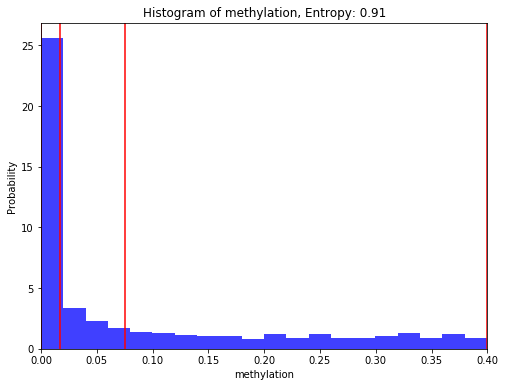

In [95]:
METHY_K_LESS = 1
FILE_NAME = FILE_NAME_DICT[METHY_K_LESS]
DATA_FP = os.path.join(DATA_SET_DIR, "DATA", FILE_NAME + ".tsv")
FIGURE_DIR = os.path.join("../FIGURES/Filtered_Feature_Analysis/", FILE_NAME)
mkdirs([FIGURE_DIR])
for K_analyze in [False]:#, True
    FIG_DIR = PREPARE_FIG_DIR(FIGURE_DIR, K_analyze)
    COL_INDEX = 4 if K_analyze else 3
    hist_K_with_5_percentiles(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX, FIG_DIR)

In [86]:
def plot_ChrMM(DATA_FP, K_analyze, COL_INDEX, METHY_K_LESS, METHY_LESS_NAME, FIG_DIR, CLASS_LABELS):
    dist_dict = {}
    entropy_dict = {}
    fig_dir = os.path.join(FIG_DIR, "ChromHMM")
    mkdirs([fig_dir])
    cm = plt.get_cmap('gist_rainbow')
    ind = np.arange(len(CLASS_LABELS))
    chrHMMs = np.arange(NUMBER_OF_CHRMM_CLASS)
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    df_indexs_arr, df, percentiles = get_percentile_index_arr(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX)

    class_data = np.zeros((len(chrHMMs), len(ind)))
    class_data_non_normed = np.zeros((len(chrHMMs), len(ind)))
    class_fp = os.path.join(DATA_SET_DIR, "ChrmoHMM", METHY_LESS_NAME, "HmmH1hescHMM.csv")
    categories = pd.read_csv(class_fp, sep="\t", header=None).values
    for cid, class_label in enumerate(CLASS_LABELS):
        classes = categories[df_indexs_arr[cid], -1].astype(int)
        unique, counts = np.unique(classes, return_counts=True)
        unique = unique.astype(int)
        normed_counts = counts / float(counts.sum())
        unique_dc = dict(zip(unique, normed_counts))
        unique_dc_non_normed = dict(zip(unique, counts))
        for cls in chrHMMs:
            class_data[cls][cid] = unique_dc[cls + 1]
            class_data_non_normed[cls][cid] = unique_dc_non_normed[cls + 1]
    pls = []
    for cls in chrHMMs:
        if cls == 0:
            pl = ax.bar(ind, tuple(list(class_data[cls, :])), 0.35)
        else:
            sum_prev = list(np.sum(class_data[0: cls, :], axis=0))
            pl = ax.bar(ind, tuple(list(class_data[cls, :])), 0.35, bottom=tuple(sum_prev))
        for item in pl:
            item.set_color(cm(1. * cls / NUMBER_OF_CHRMM_CLASS))
        pls.append(pl)
    ax.set_xlabel('ChromHMM Class')
    ax.set_ylabel('Percentage')
    ax.set_xticks(ind)
    ax.set_xticklabels(CLASS_LABELS)
    ax.set_yticks(np.arange(0.2, 1.1, 0.2))
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.7, box.height])
    ax.legend(tuple(pls), tuple(ChrmoHMM_LABELS), loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig(os.path.join(fig_dir, "ChromHMM_PERCENTAGE_OF_K.png"), dpi=200)

    N_ROW = 3
    N_COL = 5
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))

    for cls in chrHMMs:
        row = int(cls / N_COL)
        col = int(cls % N_COL)
        ax = axs[row][col]
        y_max = np.max(class_data[cls, :]) + 0.08
        pl = ax.bar(ind, tuple(list(class_data[cls, :])), 0.35)
        for item in pl:
            item.set_color(cm(1. * cls / NUMBER_OF_CHRMM_CLASS))
        for cid, class_label in enumerate(CLASS_LABELS):
            ax.text(ind[cid] - 0.2, class_data[cls, cid] + 0.002, str(round(class_data[cls, cid] * 100.0, 2)) + "%",
                    fontsize=14, weight="bold")
        if col == 0:
            ax.set_ylabel('Percentage')
        ax.set_xticks(ind)
        ax.set_xticklabels(CLASS_LABELS, fontsize=10)
        ax.set_ylim(0, y_max)
        ax.set_title(ChrmoHMM_LABELS[cls], fontsize=18)
    plt.savefig(os.path.join(fig_dir, "ChromHMM_SEP_PERCENTAGE_OF_K.png"), dpi=200)

    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    for cls in chrHMMs:
        row = int(cls / N_COL)
        col = int(cls % N_COL)
        ax = axs[row][col]
        class_data_non_normed[cls, :] = class_data_non_normed[cls, :] / np.sum(class_data_non_normed[cls, :])
        pl = ax.bar(ind, tuple(list(class_data_non_normed[cls, :])), 0.35)
        for item in pl:
            item.set_color(cm(1. * cls / NUMBER_OF_CHRMM_CLASS))
        for cid, class_label in enumerate(CLASS_LABELS):
            ax.text(ind[cid] - 0.2, class_data_non_normed[cls, cid] + 0.002,
                    str(round(class_data_non_normed[cls, cid] * 100.0, 2)) + "%", fontsize=14, weight="bold")
        if col == 0:
            ax.set_ylabel('Percentage')
        ax.set_xticks(ind)
        ax.set_xticklabels(CLASS_LABELS, fontsize=10)
        y_max = np.max(class_data_non_normed[cls, :]) + 0.08
        ax.set_ylim(0, y_max)
        ax.set_title(ChrmoHMM_LABELS[cls], fontsize=18)
    plt.savefig(os.path.join(fig_dir, "ChromHMM_SEP_PERCENTAGE_OF_ChroMM.png"), dpi=200)

    # Plot the pdf
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    if K_analyze:
        if LOG_SCALE:
            xlim = [-1, 1]
        else:
            xlim = [0, 10]
    else:
        if METHY_K_LESS == 1:
            xlim = [0, 0.4]
        elif METHY_K_LESS == 2:
            xlim = [0.4, 0.8]
        else:
            xlim = [0.8, 1]
    for cls in chrHMMs:
        row = int(cls / N_COL)
        col = int(cls % N_COL)
        ax = axs[row][col]
        ks_indexs = categories[:, -1].astype(int) == (cls + 1)
        ks = df[ks_indexs, COL_INDEX]
        xhist, _, _ = ax.hist(df[:, COL_INDEX], bins=NBIN, density=True, color='black', edgecolor='black', alpha=0.5,
                              linewidth=0.5)  #
        yhist, _, _ = ax.hist(ks, bins=NBIN, density=True, color=cm(1. * cls / NUMBER_OF_CHRMM_CLASS),
                              edgecolor='black', alpha=0.5, linewidth=0.5)  #
        if JSD:
            distance = jensenshannon(xhist, yhist)
        else:
            max_mi = calc_MI(xhist, xhist, MI_BIN)
            mi = calc_MI(xhist, yhist, MI_BIN) / max_mi
            distance = 1 - mi
        dist_dict[ChrmoHMM_LABELS[cls]] = distance
        pK = yhist / yhist.sum()
        entropy = -np.sum(pK * np.log10(pK))
        entropy_dict[ChrmoHMM_LABELS[cls]] = entropy
        print(ChrmoHMM_LABELS[cls] + "\t" + str(round(float(distance), 2)))
        ax.text(float(np.mean(np.array(xlim))), max([float(np.max(xhist)), float(np.max(yhist))]) * 0.75,
                "%s:%.2f" % (METRIC, distance), color='black', fontsize=18)

        ax.text(float(np.mean(np.array(xlim))), max([float(np.max(xhist)), float(np.max(yhist))]) * 0.6,
                "%s:%.2f" % ("Entropy", entropy), color='black', fontsize=18)
        ax.set_ylabel('Probability')
        ax.set_xlim(xlim)
        ax.set_title(ChrmoHMM_LABELS[cls], fontsize=18)
    plt.savefig(os.path.join(fig_dir, "ChromHMM_DIST_ChroMM_" + METRIC + ".png"), dpi=200)
    return [dist_dict, entropy_dict]

In [87]:
def plot_K_hist_in_different_markers(DATA_FP, BASE_DIR, SUB_DIR_NAME, K_analyze, COL_INDEX, METHY_K_LESS, FIG_DIR, CLASS_LABELS):
    dist_dict = {}
    entropy_dict = {}
    df_indexs_arr, df, _ = get_percentile_index_arr(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX)
    ind = np.arange(len(CLASS_LABELS))
    cm = plt.get_cmap('gist_rainbow')
    input_fps = []
    file_names = []
    for file_name in os.listdir(BASE_DIR):
        if file_name.endswith(".csv"):
            input_fps.append(os.path.join(BASE_DIR, file_name))
            file_names.append(file_name.strip(".csv"))
    N_FILES = len(input_fps)
    N_COL = 5
    Max_NROW = 3
    N_SUBFIG_PER_FIG = Max_NROW * N_COL
    NFIG = int(math.ceil(N_FILES / N_SUBFIG_PER_FIG))
    fig_dir = os.path.join(FIG_DIR, SUB_DIR_NAME)
    mkdirs([fig_dir])
    for i in range(NFIG):
        if NFIG > 1:
            fig_fp = os.path.join(fig_dir, SUB_DIR_NAME + "_" + str(i) + ".png")
        else:
            fig_fp = os.path.join(fig_dir, SUB_DIR_NAME + ".png")
        base_index = i * N_SUBFIG_PER_FIG
        N_remaining_files = N_FILES - base_index
        N_ROW = int(math.ceil((N_remaining_files) / N_COL)) if N_remaining_files <= N_SUBFIG_PER_FIG else Max_NROW

        fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
        SUB_FIG_RANGE = N_SUBFIG_PER_FIG if N_remaining_files > N_SUBFIG_PER_FIG else N_remaining_files

        for j in range(SUB_FIG_RANGE):
            row = j // N_COL
            col = j % N_COL
            if N_ROW == 1:
                ax = axs[col]
            else:
                ax = axs[row][col]
            index = base_index + j
            class_fp = input_fps[index]
            categories = pd.read_csv(class_fp, sep="\t", header=None).values
            class_data = []
            cat_indexs = categories[:, -1].astype(int) == 1
            for cid, class_label in enumerate(CLASS_LABELS):
                df_indexs = df_indexs_arr[cid]
                intersect = np.logical_and(df_indexs, cat_indexs)
                # int_data = df[intersect]
                cls_count = np.sum(categories[intersect, -1])
                class_data.append(cls_count)
            class_data = np.array(class_data)
            class_data = class_data[:] / np.sum(class_data)
            y_max = np.max(class_data) + 0.08
            pl = ax.bar(ind, tuple(list(class_data)), 0.35)
            for item in pl:
                item.set_color(cm(1. * j / SUB_FIG_RANGE))
            for cid, class_label in enumerate(CLASS_LABELS):
                ax.text(ind[cid] - 0.2, class_data[cid] + 0.002,
                        str(round(class_data[cid] * 100.0, 2)) + "%", fontsize=10, weight="bold")
            if col == 0:
                ax.set_ylabel("Percentage", fontsize=18)
            ax.set_xticks(ind)
            ax.set_xticklabels(CLASS_LABELS, fontsize=12)
            ax.set_xlim(-0.5, len(CLASS_LABELS) - 0.5)
            ax.set_ylim(0, y_max)
            ax.set_title(file_names[index], fontsize=18)
        plt.savefig(fig_fp, dpi=200)
        if NFIG > 1:
            fig_fp = os.path.join(fig_dir, SUB_DIR_NAME + "_DIST_" + str(i) + "_" + METRIC + ".png")
        else:
            fig_fp = os.path.join(fig_dir, SUB_DIR_NAME + "_DIST_" + METRIC + ".png")
        # Plot the pdf
        if K_analyze:
            if LOG_SCALE:
                xlim = [-1, 1]
            else:
                xlim = [0, 10]
        else:
            if METHY_K_LESS == 1:
                xlim = [0, 0.4]
            elif METHY_K_LESS == 2:
                xlim = [0.4, 0.8]
            else:
                xlim = [0.8, 1]
        fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
        for j in range(SUB_FIG_RANGE):
            row = j // N_COL
            col = j % N_COL
            if N_ROW == 1:
                ax = axs[col]
            else:
                ax = axs[row][col]
            index = base_index + j
            class_fp = input_fps[index]
            categories = pd.read_csv(class_fp, sep="\t", header=None).values
            class_data = []
            ks_indexs = categories[:, -1].astype(int) == 1
            ks = df[ks_indexs, COL_INDEX]
            xhist, _, _ = ax.hist(df[:, COL_INDEX], bins=NBIN, density=True, color='black', edgecolor='black',
                                  alpha=0.5,
                                  linewidth=0.5)  #
            yhist, _, _ = ax.hist(ks, bins=NBIN, density=True, color=cm(1. * j / SUB_FIG_RANGE), edgecolor='black',
                                  alpha=0.5, linewidth=0.5)  #
            if JSD:
                distance = jensenshannon(xhist, yhist)
            else:
                max_mi = calc_MI(xhist, xhist, MI_BIN)
                mi = calc_MI(xhist, yhist, MI_BIN) / max_mi
                distance = 1 - mi
            print(file_names[index] + "\t" + str(round(float(distance), 2)))
            dist_dict[file_names[index]] = distance
            pK = yhist / yhist.sum()
            entropy = -np.sum(pK * np.log10(pK))
            entropy_dict[file_names[index]] = entropy
            ax.text(float(np.mean(np.array(xlim))), max([float(np.max(xhist)), float(np.max(yhist))]) * 0.75,
                    "%s:%.2f" % (METRIC, distance), color='black', fontsize=18)

            ax.text(float(np.mean(np.array(xlim))), max([float(np.max(xhist)), float(np.max(yhist))]) * 0.6,
                    "%s:%.2f" % ("Entropy", entropy), color='black', fontsize=18)
            ax.set_ylabel('Probability')
            ax.set_xlim(xlim)
            ax.set_title(file_names[index], fontsize=18)
        plt.savefig(fig_fp, dpi=200)
    return [dist_dict, entropy_dict]

In [102]:
def run_plot_pipeline():
    DATA_RECORDS = []
    for K_analyze in [False,True]:# 
        for METHY_K_LESS in [1, 2, 3]: 
            TMP_ARR = []
            FILE_NAME = FILE_NAME_DICT[METHY_K_LESS]
            DATA_FP = os.path.join(DATA_SET_DIR, "DATA", FILE_NAME + ".tsv")
            FIGURE_DIR = os.path.join("../FIGURES/Filtered_Feature_Analysis/", FILE_NAME)
            mkdirs([FIGURE_DIR])
            CLASS_LABELS = ['slowest', 'slow', 'middle', 'fast', 'fastest'] if K_analyze else ['0%-50%',
                                                                                               '50%-65%',
                                                                                               '>65%']
            N_CLASSES = len(CLASS_LABELS)

            FIG_DIR = PREPARE_FIG_DIR(FIGURE_DIR, K_analyze)
            COL_INDEX = 4 if K_analyze else 3
#             hist_K_with_5_percentiles(DATA_FP, METHY_K_LESS, K_analyze, COL_INDEX, FIG_DIR)
#             element = plot_ChrMM(DATA_FP, K_analyze, COL_INDEX, METHY_K_LESS, FILE_NAME, FIG_DIR, CLASS_LABELS)
#             TMP_ARR.append(element)
            regions = ["ADDED"]  # "General", "Genomic_Regions", "Histone_Modification", "Histone_Modification_Enzyme","TFBS"
            for REGION in regions:
                element = plot_K_hist_in_different_markers(DATA_FP, os.path.join(DATA_SET_DIR, REGION, FILE_NAME), REGION,
                                                           K_analyze,
                                                           COL_INDEX, METHY_K_LESS, FIG_DIR, CLASS_LABELS)
                TMP_ARR.append(element)

Methy_JSD
[0.0, 0.0172415, 0.075, 0.39963000000000004]
SIX5	0.32
ATF2	0.18
POU5F1	0.09
TAF1	0.25
SP4	0.24
SP1	0.2
EZH2	0.17
BCL11A	0.09
DNase	0.07
CMYC	0.24
TBP	0.24
SP2	0.32
POL2	0.25
NANOG	0.09
RBBP5	0.22
CEBPB	0.1
CHD1	0.22
CTCF	0.05
CHD2	0.26
P300	0.17
SUZ12	0.19
Methy_JSD
[0.4, 0.714286, 0.75, 0.7999095]
SIX5	0.22
ATF2	0.24
POU5F1	0.24
TAF1	0.27
SP4	0.26
SP1	0.25
EZH2	0.33
BCL11A	0.26
DNase	0.18
CMYC	0.26
TBP	0.26
SP2	0.24
POL2	0.25
NANOG	0.3
RBBP5	0.27
CEBPB	0.18
CHD1	0.26
CTCF	0.17
CHD2	0.27
P300	0.26
SUZ12	0.28
Methy_JSD
[0.8, 0.9545450000000001, 0.977778, 1.0]
SIX5	0.2
ATF2	0.19
POU5F1	0.22
TAF1	0.21
SP4	0.2
SP1	0.18
EZH2	0.21
BCL11A	0.35


/Users/emmanueldollinger/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:112: RuntimeWarning: divide by zero encountered in log10
/Users/emmanueldollinger/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:112: RuntimeWarning: invalid value encountered in multiply


DNase	0.19
CMYC	0.26
TBP	0.19
SP2	0.19
POL2	0.13
NANOG	0.3
RBBP5	0.22
CEBPB	0.06
CHD1	0.19
CTCF	0.17
CHD2	0.21
P300	0.27
SUZ12	0.23
K_JSD
[0.0, 0.2692, 0.4169, 0.5888, 0.8913, 9.7724]
SIX5	0.26
ATF2	0.12
POU5F1	0.1
TAF1	0.13
SP4	0.14
SP1	0.12
EZH2	0.11
BCL11A	0.11
DNase	0.07
CMYC	0.11
TBP	0.13
SP2	0.14
POL2	0.13
NANOG	0.12
RBBP5	0.13
CEBPB	0.08
CHD1	0.12
CTCF	0.08
CHD2	0.11
P300	0.12
SUZ12	0.11
K_JSD
[0.0, 0.912, 1.6218, 2.884, 4.6774, 10.0]
SIX5	0.23
ATF2	0.22
POU5F1	0.31
TAF1	0.27
SP4	0.27
SP1	0.29
EZH2	0.35
BCL11A	0.37
DNase	0.13
CMYC	0.28
TBP	0.26
SP2	0.3
POL2	0.21
NANOG	0.34
RBBP5	0.26
CEBPB	0.14
CHD1	0.24
CTCF	0.18
CHD2	0.25
P300	0.32
SUZ12	0.27
K_JSD
[0.0, 1.6982, 3.1623, 4.5709, 6.0256, 10.0]
SIX5	0.17
ATF2	0.13
POU5F1	0.22
TAF1	0.18
SP4	0.16
SP1	0.15
EZH2	0.28
BCL11A	0.3
DNase	0.06
CMYC	0.21
TBP	0.16
SP2	0.16
POL2	0.07
NANOG	0.26
RBBP5	0.18
CEBPB	0.04
CHD1	0.13
CTCF	0.09
CHD2	0.16
P300	0.25
SUZ12	0.11


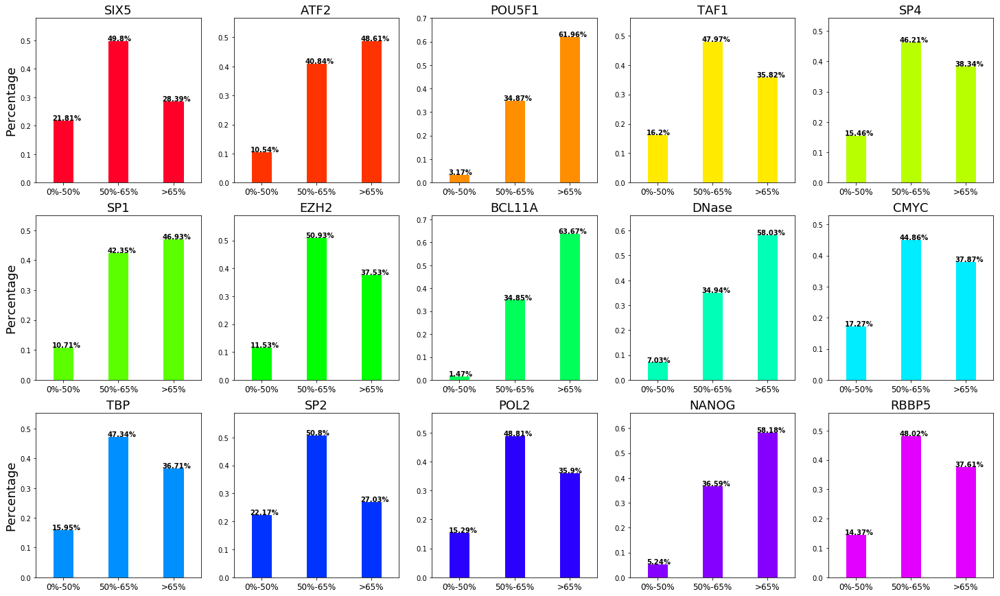

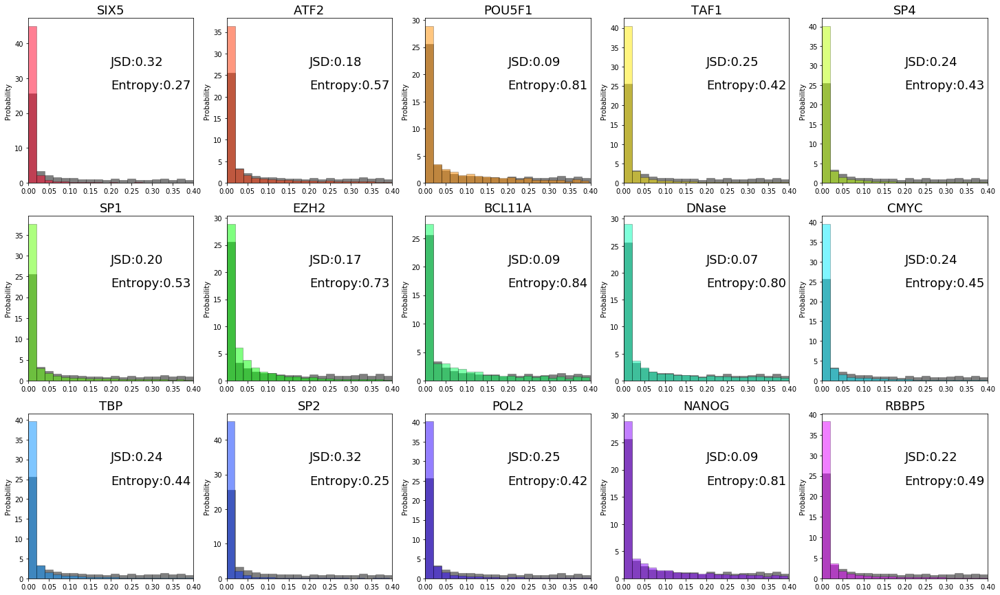

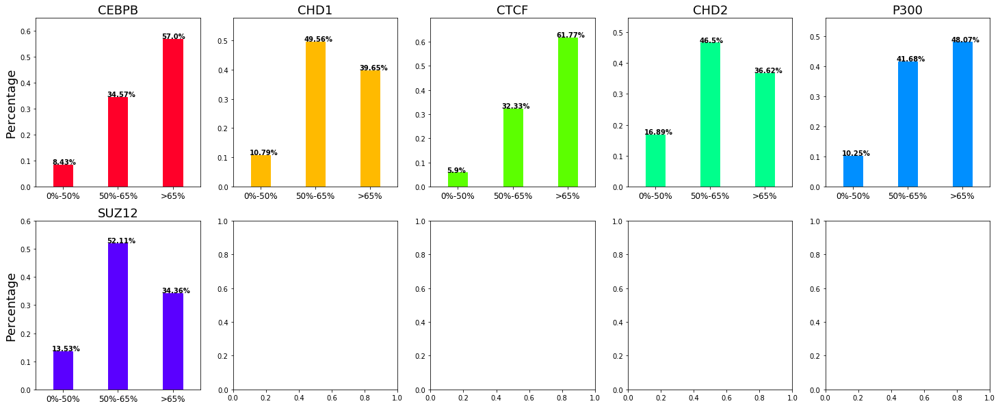

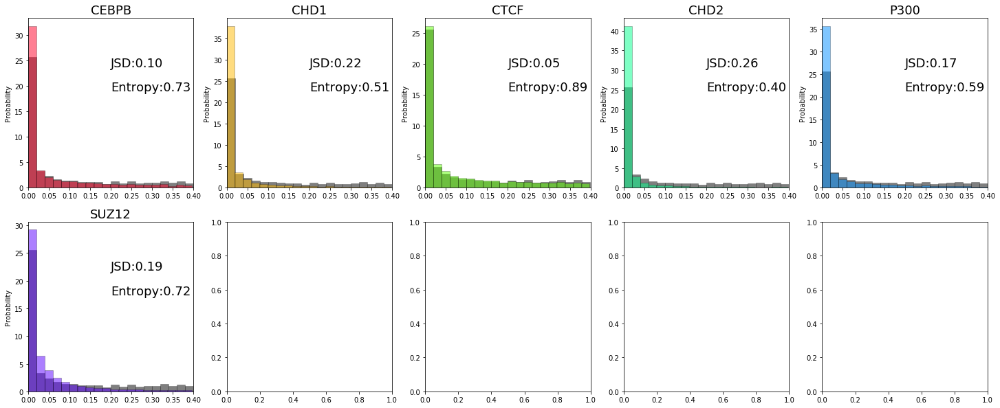

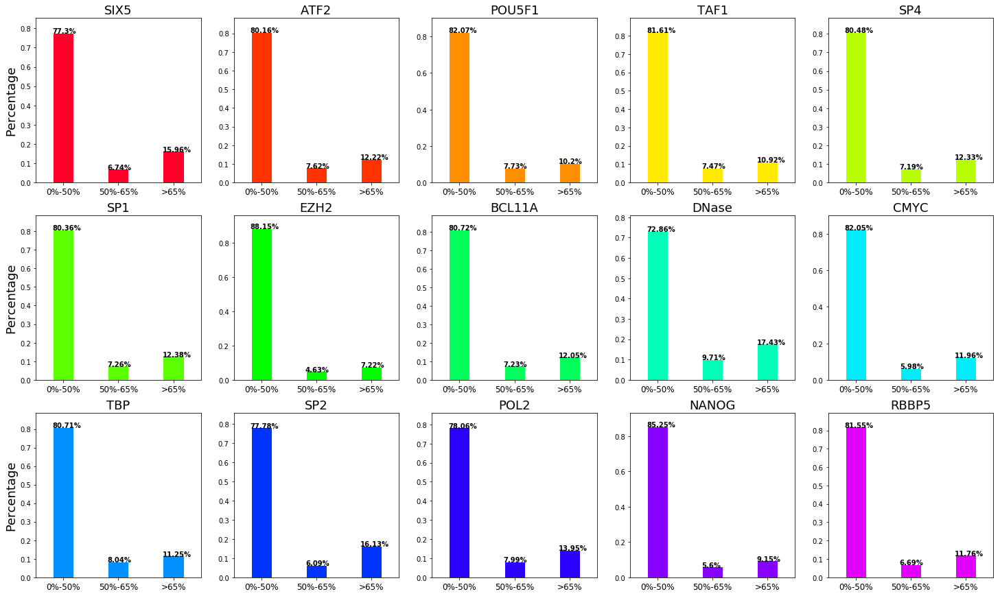

...

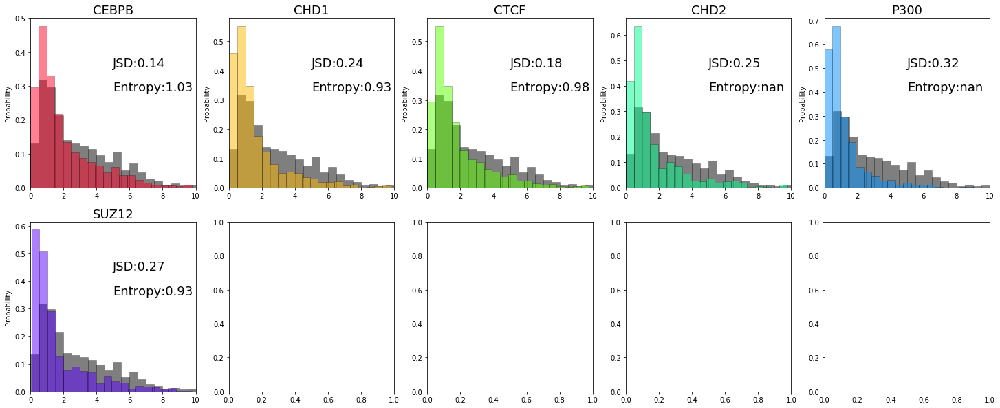

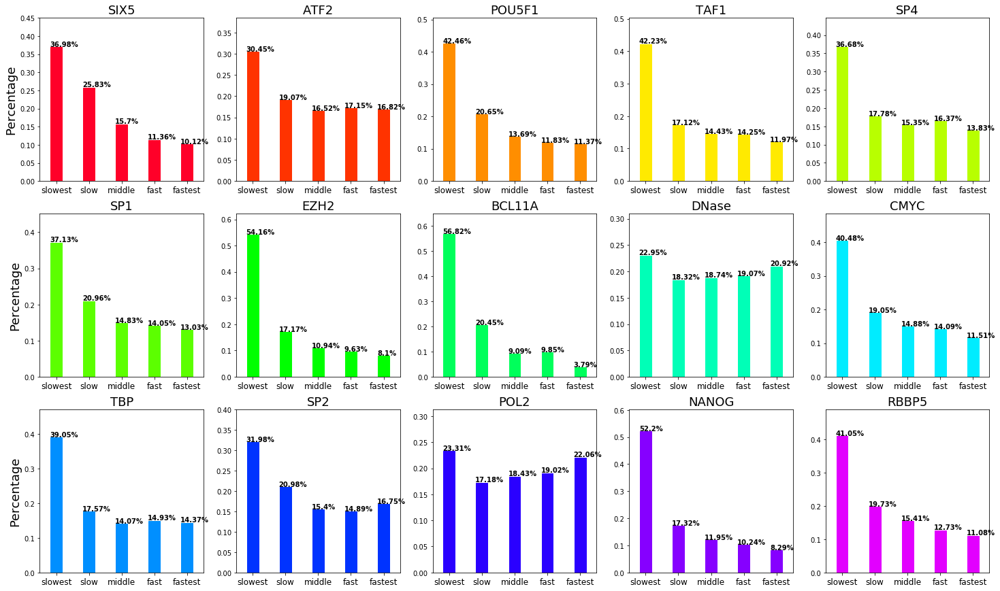

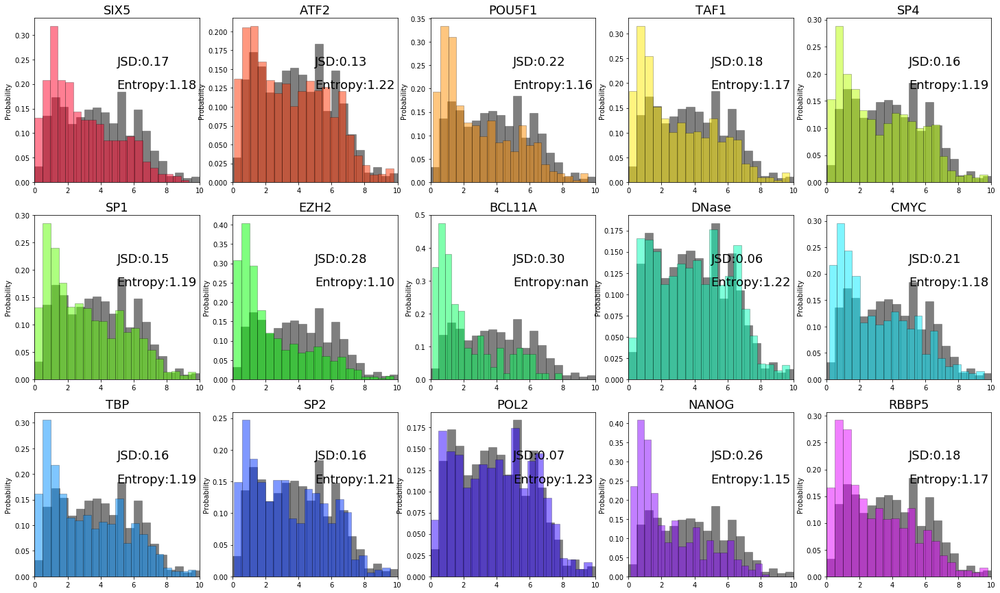

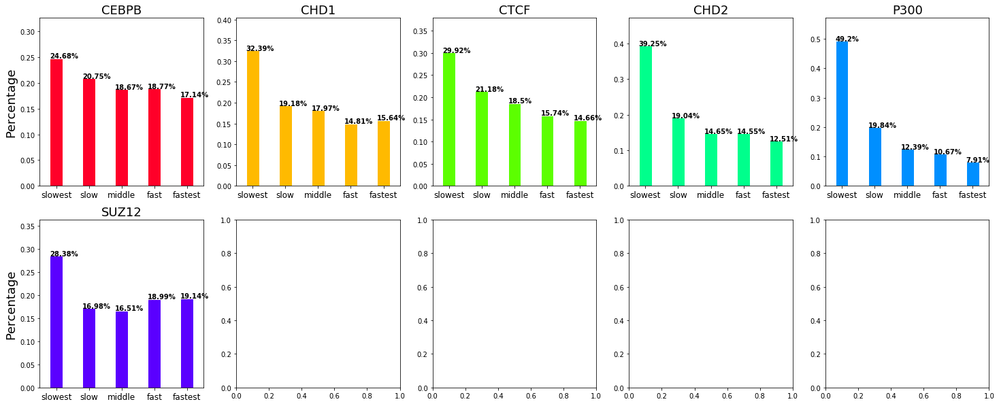

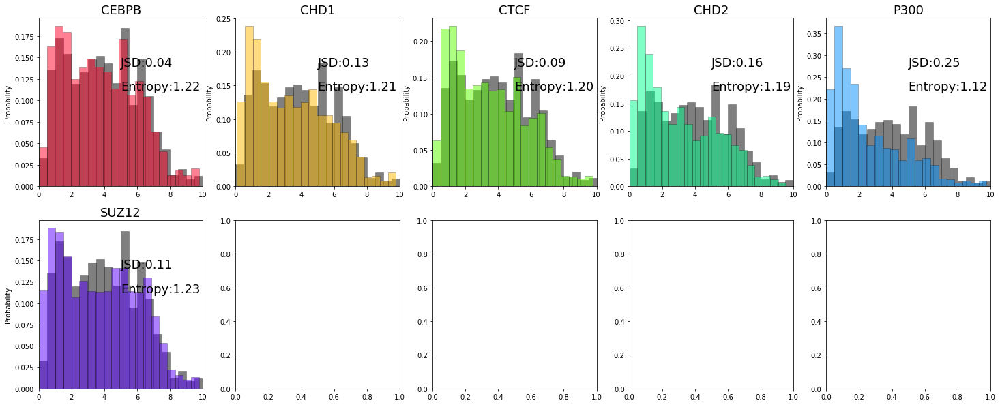

In [103]:
run_plot_pipeline()

In [41]:
def plot_k_histogram_versus_diff_methylation_interval(LOG10=True):
    data_fp = os.path.join(DATA_SET_DIR, "DATA", "METHY_AND_K.tsv")
    FIGURE_DIR = "../FIGURES/Filtered_Feature_Analysis/"
    df = pd.read_csv(data_fp, sep='\t', header=None).values
    METHY_COL_IDNEX = 3
    K_COL_INDEX = 4
    BINS = 30
    N_COL = 5
    N_ROW = 2
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    METHY_LOWER_BOUNDS = [i*0.1 for i in range(0, 10)]
    TITLE_LABELS = ["%.1f-%.1f" %(item, item + .1) for item in METHY_LOWER_BOUNDS]

    for m_idx, methy_lower_bound in enumerate(METHY_LOWER_BOUNDS):
        row = int(m_idx / N_COL)
        col = int(m_idx % N_COL)
        ax = axs[row][col]
        Methys = df[:, METHY_COL_IDNEX]
        target_methy_rows = np.logical_and(Methys > methy_lower_bound, Methys < (methy_lower_bound + 0.1))
        Ks = df[target_methy_rows , K_COL_INDEX]
        if LOG10:
            Ks[Ks <= 0] = 0.001
            Ks = np.log10(Ks)
            Ks = Ks[Ks>-1]
        xhist, _, _ = ax.hist(Ks, BINS, density=True, facecolor='b', alpha=0.75, edgecolor='black', linewidth=0.5)
        pK = xhist / xhist.sum()
        entropy = -np.sum(pK * np.log10(pK))
        ax.set_xlabel('K')
        ax.set_ylabel('Probability')
        ax.set_title("Methy in %s, Entropy: %.2f" % (TITLE_LABELS[m_idx], entropy))
        if LOG10:
            ax.set_xlim([-1, 1])
            ax.set_ylim([0, 2])
        else:
            ax.set_xlim([0, 10])
            ax.set_ylim([0, 1.5])
        
    plt.savefig(os.path.join(FIGURE_DIR, "Hist_OF_K_IN_DIFF_METHY_INTERVAL.png"), dpi=200)

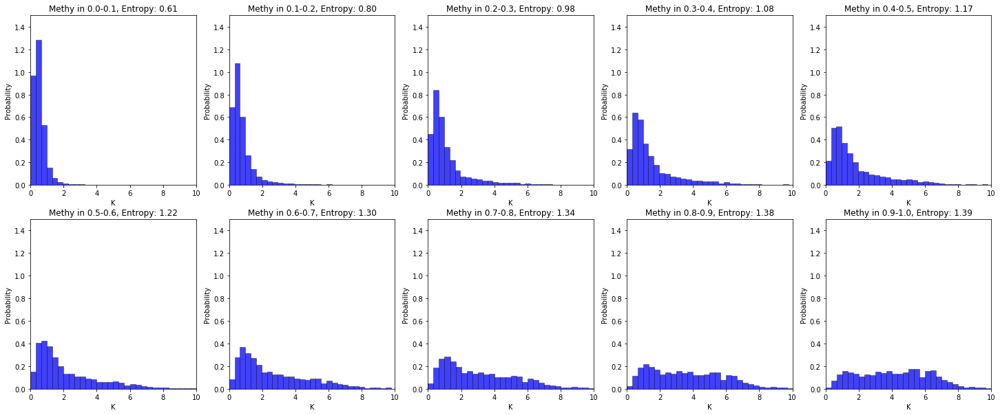

In [39]:
plot_k_histogram_versus_diff_methylation_interval(False)

In [74]:
def hist2d_k_versus_diff_methylation_interval(LOG10=True):
    data_fp = os.path.join(DATA_SET_DIR, "DATA", "METHY_AND_K.tsv")
    FIGURE_DIR = "../FIGURES/Filtered_Feature_Analysis/"
    df = pd.read_csv(data_fp, sep='\t', header=None).values
    METHY_COL_IDNEX = 3
    K_COL_INDEX = 4
    BINS = 30
    N_ROW = 1
    Step = 0.33
    N_COL = int(1/Step)
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    METHY_LOWER_BOUNDS = [i*Step for i in range(0, N_COL)]
    TITLE_LABELS = ["%.1f-%.1f" %(item, item + Step) for item in METHY_LOWER_BOUNDS]

    for m_idx, methy_lower_bound in enumerate(METHY_LOWER_BOUNDS):
        ax = axs[m_idx]
        Methys = df[:, METHY_COL_IDNEX]
        target_methy_rows = np.logical_and(Methys > methy_lower_bound, Methys < (methy_lower_bound + Step))
        Ks = df[target_methy_rows , K_COL_INDEX]
        Methys = df[target_methy_rows, METHY_COL_IDNEX]
        if LOG10:
            Ks[Ks <= 0] = 0.001
            Ks = np.log10(Ks)
            indexs =Ks>-1
            Ks = Ks[indexs]
            Methys = Methys[indexs]
            ylabel= 'log10(K)'
        else:
            ylabel= 'K'
        corr_coef = np.corrcoef(Methys, Ks)[0][1]
        ax.hist2d(Methys, Ks, bins=(30, 30), normed=True)
        ax.set_xlabel('Methy')
        ax.set_ylabel(ylabel)
        ax.set_title("Hist2d of %s and Methy with Corr %.2f" % (ylabel, corr_coef))
        if LOG10:
            ax.set_ylim([-1, 1])
        else:
            ax.set_ylim([0, 10])
        ax.set_xlim([methy_lower_bound, methy_lower_bound + Step])
        
    plt.savefig(os.path.join(FIGURE_DIR, "Hist2d_OF_K_IN_DIFF_METHY_INTERVAL.png"), dpi=200)

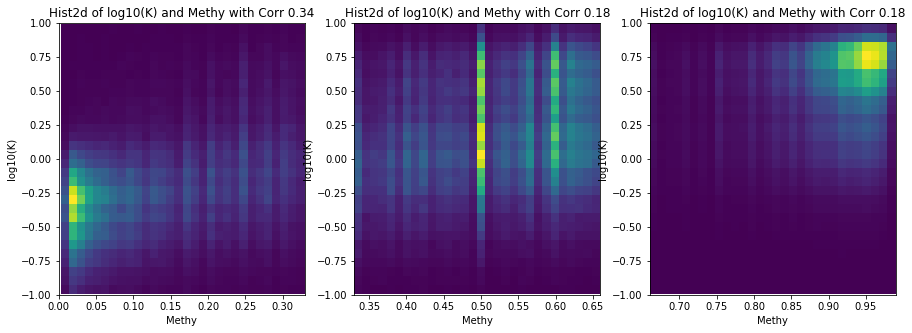

In [75]:
hist2d_k_versus_diff_methylation_interval(True)

In [ ]:
def plot_k_histogram_versus_CG_content_interval(LOG10=True):
    N_ROW = 1
    N_COL = 3
    COLORS = ['black', 'green', 'red']
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    FIGURE_DIR = "../FIGURES/Filtered_Feature_Analysis/CG_Analysis"
    mkdirs([FIGURE_DIR])
    METHYS = [1, 2, 3]
    CG_COL_IDNEX = 6
    METHY_COL_IDNEX = 3
    K_COL_INDEX = 4

    BINS = 20
    Step = 0.33
    CG_LOWER_BOUNDS = [i*Step for i in range(0, N_COL)]
    TITLE_LABELS = ["CG %.1f-%.1f" %(item, item + Step) for item in CG_LOWER_BOUNDS]
    
    for idx, METHY_K_LESS in enumerate(METHYS):
        data_fp = os.path.join(DATA_SET_DIR, "CG_Analysis", "%s_CG.bed" % FILE_NAME_DICT[METHY_K_LESS])
        df = pd.read_csv(data_fp, sep='\t', header=None).values
        ax = axs[idx]
        pls = []
        for m_idx, cg_lower_bound in enumerate(CG_LOWER_BOUNDS):
            CGs = df[:, CG_COL_IDNEX]
            target_methy_rows = np.logical_and(CGs > cg_lower_bound, CGs < (cg_lower_bound + Step))
            Ks = df[target_methy_rows , K_COL_INDEX]
            CGs = df[target_methy_rows, METHY_COL_IDNEX]
            if LOG10:
                Ks[Ks <= 0] = 0.001
                Ks = np.log10(Ks)
                indexs =Ks>-1
                Ks = Ks[indexs]
                CGs = CGs[indexs]
                ylabel= 'log10(K)'
            else:
                ylabel= 'K'
            pl = ax.hist(Ks, BINS, density=True, color= COLORS[m_idx], alpha=0.5, edgecolor='black', linewidth=0.5)
            pls.append(pl)
        if not idx:
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.7, box.height])
            ax.legend(tuple(TITLE_LABELS), loc='center left', bbox_to_anchor=(1, 0.5))
            ax.set_ylabel('Probability')
        ax.set_xlabel('K')
        ax.set_title("%s" % (FILE_NAME_LABEL[METHY_K_LESS]))
        if LOG10:
            ax.set_xlim([-1, 1])
        else:
            ax.set_xlim([0, 10])
        ax.set_ylim([0, 1.2])

    plt.savefig(os.path.join(FIGURE_DIR, "Hist_OF_K_IN_CG.png"), dpi=200)

In [ ]:
plot_k_histogram_versus_CG_content_interval(False)

In [6]:
K_Cluster_dir = os.path.join(DATA_SET_DIR, "K_Cluster_Analysis")
data_fp = os.path.join(K_Cluster_dir, "Cluster_ChromoHMM.bed")
df = pd.read_csv(data_fp, sep='\t', header=None).values
data_to_cluster = df[:, 3: -1]

In [7]:
from time import time
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture

In [8]:
K_Cluster_dir = os.path.join(DATA_SET_DIR, "K_Cluster_Analysis")
data_fp = os.path.join(K_Cluster_dir, "Cluster_ChromoHMM.tsv")
df = pd.read_csv(data_fp, sep='\t', header=None).values
data_to_cluster = df[:, 3: -1]
chromoHMM_labels = df[:, -1].astype(int)
cluster_fig_dir = os.path.join("../FIGURES/Filtered_Feature_Analysis/", "K_Cluster")
mkdirs([cluster_fig_dir])

In [9]:
pca = PCA(n_components=2)
scaler = StandardScaler()
X = data_to_cluster 
X_scaled = scaler.fit_transform(X)
pca.fit(X_scaled)
X_pca = pca.transform(X_scaled)

In [10]:
MAX_COLOR = 20
LABLES = ['#K', "k mean", "k coef var", "methy mean", "methy coef var", "d mean", "d coef var"]
data_max_list = [np.max(data_to_cluster[:, i]) for i in range(data_to_cluster.shape[1])]
normed_data_list = [(data_to_cluster[:, i]/np.max(data_to_cluster[:, i]))*MAX_COLOR for i in range(data_to_cluster.shape[1])]

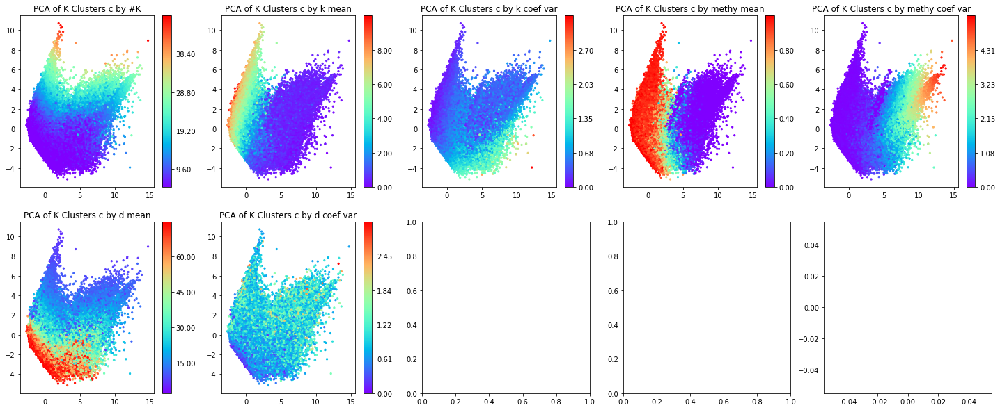

In [13]:
N_COL = 5
N_ROW = int(math.ceil(len(LABLES) / N_COL))
cm = plt.get_cmap('gist_rainbow')
fig, axs = plt.subplots(2, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
for i in range(len(LABLES)):
    row = i // N_COL
    col = i % N_COL
    ax = axs[row][col]
    sc = ax.scatter(X_pca[:, 0], X_pca[:, 1], c= normed_data_list[i], cmap=plt.cm.rainbow, s=5)
    cbar = fig.colorbar(sc, ax=ax, ticks=range(0, MAX_COLOR, 4))
    cbar.ax.set_yticklabels(["%.2f" % ((item/MAX_COLOR) * data_max_list[i])  for item in range(0, MAX_COLOR, 4)])
    ax.set_title("PCA of K Clusters c by %s" % (LABLES[i]))
plt.axis('tight')
plt.savefig(os.path.join(cluster_fig_dir, "K_Cluster_Color_by_properties.png"), dpi=200)
plt.show()

## Clustering

In [14]:
N_CLUSTER = 10

model = GaussianMixture(n_components=N_CLUSTER, covariance_type='full') # KMeans(n_clusters=N_CLUSTER)
#model = AgglomerativeClustering(n_clusters=N_CLUSTER, affinity='euclidean', linkage='ward')
model = model.fit(X_scaled)
labels = model.predict(X_scaled)

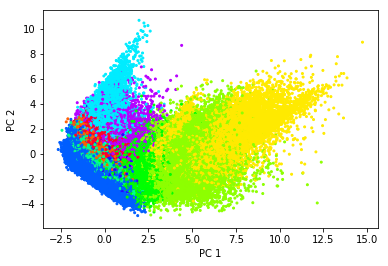

In [15]:
plt.scatter(X_pca[:, 0], X_pca[:, 1], color=cm(1. * labels / N_CLUSTER), cmap=plt.cm.rainbow,s= 4)
plt.xlabel("PC 1")
plt.ylabel("PC 2")
plt.savefig(os.path.join(cluster_fig_dir, "GaussianMixture_clustering.png"), dpi=200)
plt.show()

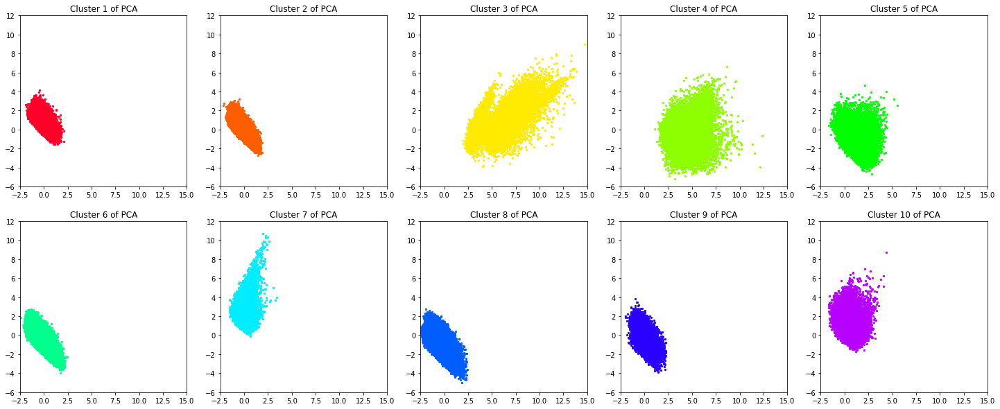

In [16]:
fig, axs = plt.subplots(2, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
#c=[ for item in range(X.shape[0])]
for cluster in range(N_CLUSTER):
    row = cluster // N_COL
    col = cluster % N_COL
    ax = axs[row][col]
    label_indexs = labels == cluster
    X = X_pca[label_indexs]
    ax.scatter(X[:, 0], X[:, 1], color=cm(1. * cluster / N_CLUSTER), cmap=plt.cm.rainbow, s=5)
    ax.set_title("Cluster %d of PCA" % (cluster + 1))
    ax.set_xlim([-2.5, 15])
    ax.set_ylim([-6, 12])
plt.savefig(os.path.join(cluster_fig_dir, "GaussianMixture_clustering_Sep.png"), dpi=200)
plt.show()

Cluster 1


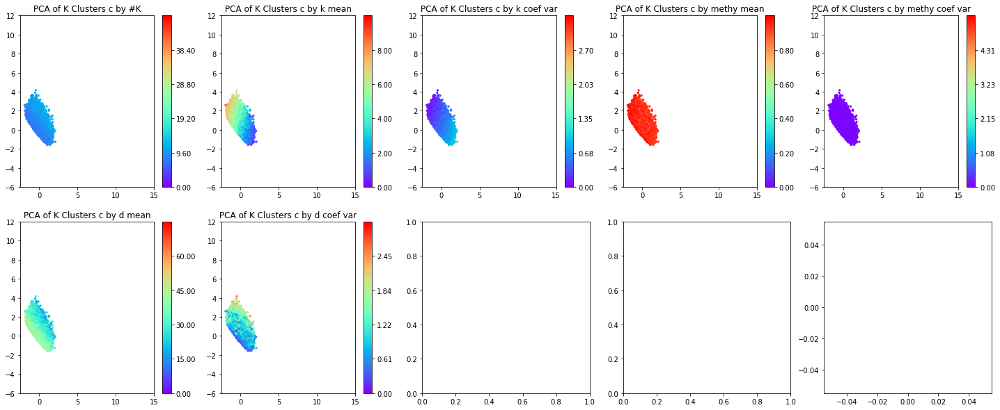

Cluster 2


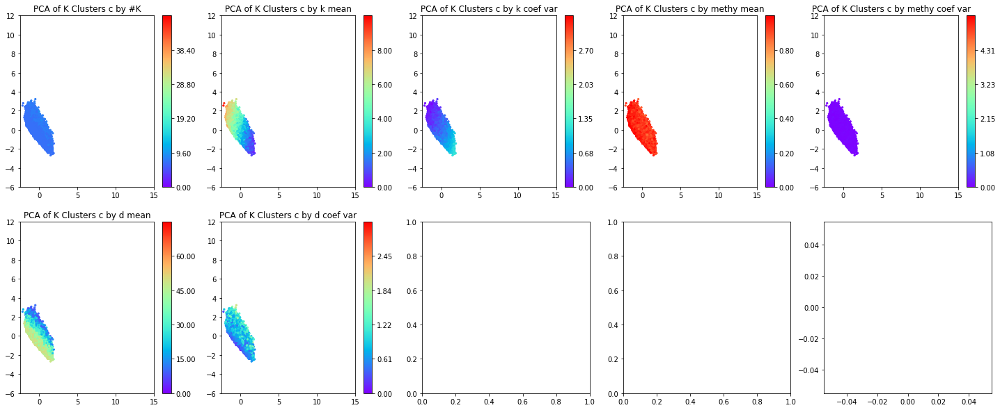

Cluster 3


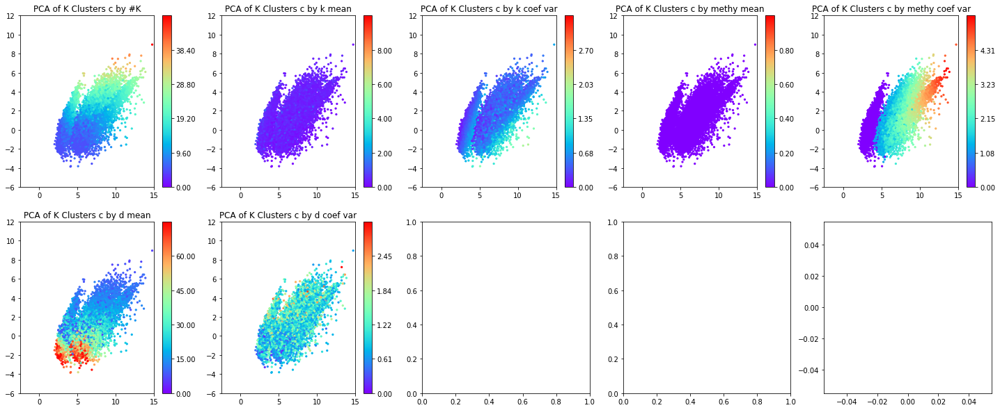

Cluster 4


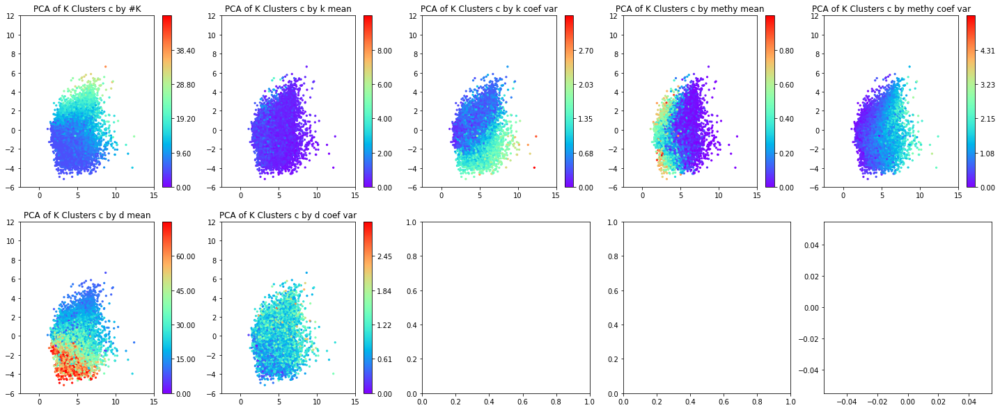

Cluster 5


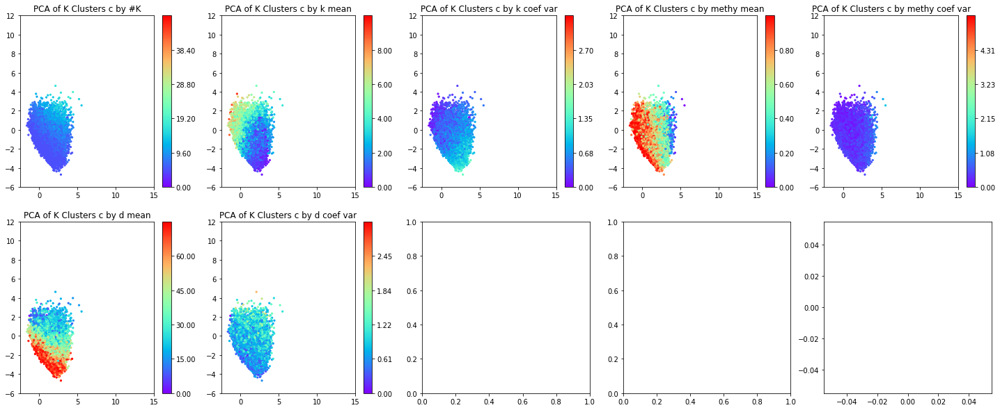

Cluster 6


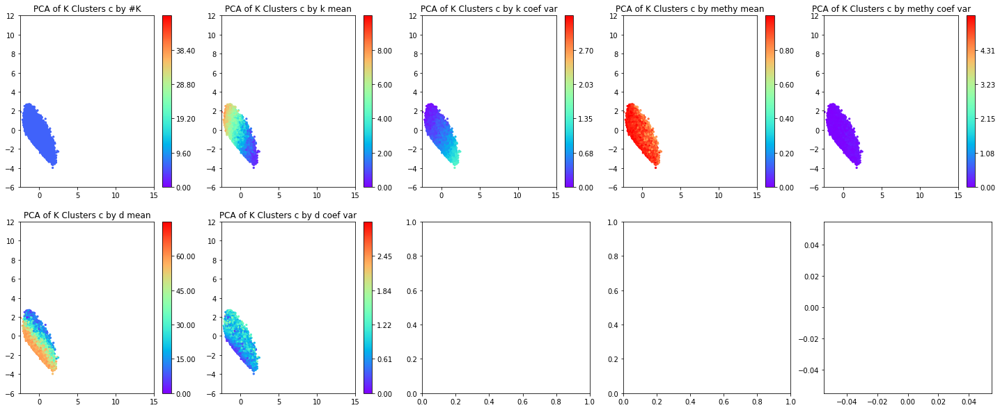

Cluster 7


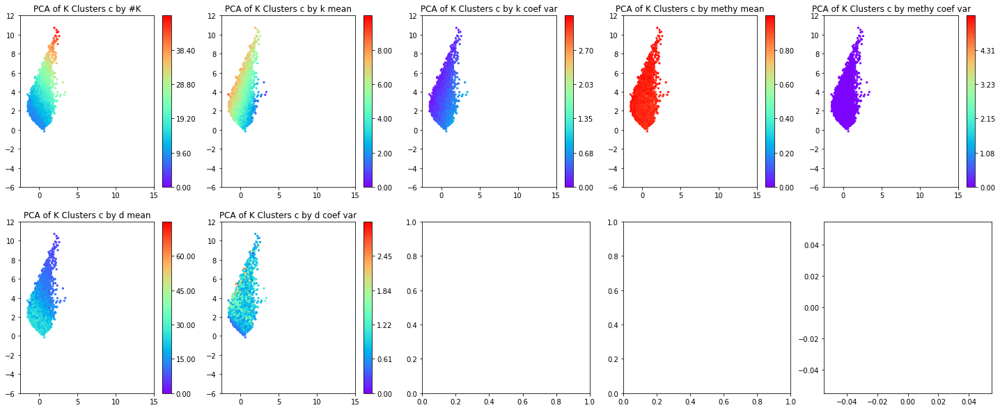

Cluster 8


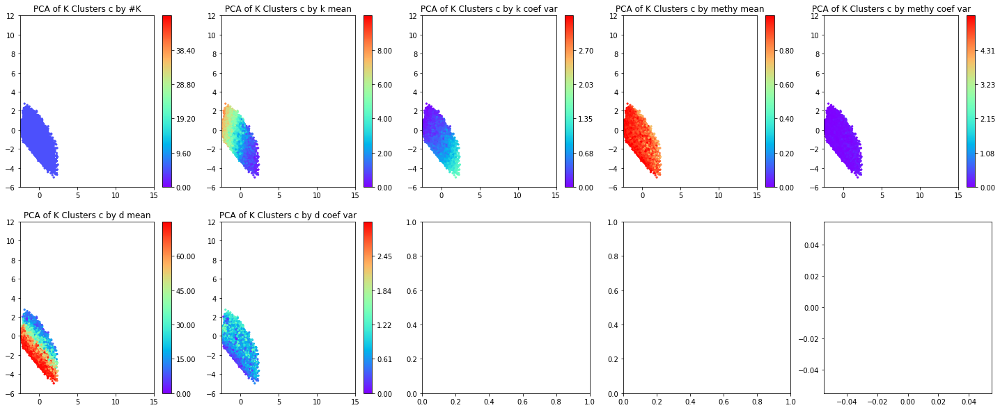

Cluster 9


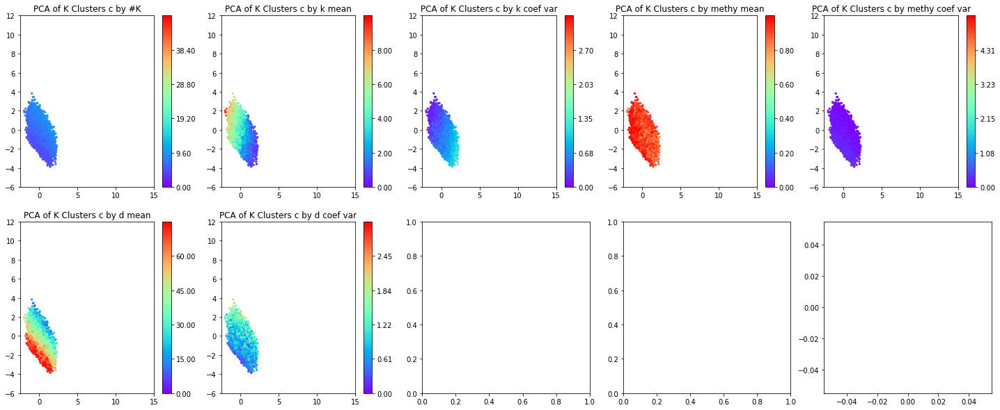

Cluster 10


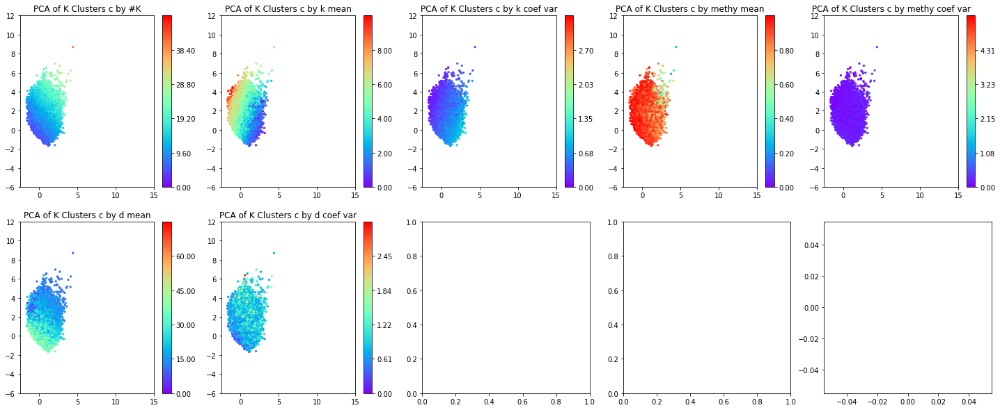

In [17]:
N_COL = 5
N_ROW = int(math.ceil(len(LABLES) / N_COL))
for cluster in range(N_CLUSTER):
    print("Cluster %d" % (cluster + 1))
    fig, axs = plt.subplots(2, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    for i in range(len(LABLES)):
        row = i // N_COL
        col = i % N_COL
        ax = axs[row][col]
        label_indexs = labels == cluster
        sc = ax.scatter(X_pca[label_indexs, 0], X_pca[label_indexs, 1], c= normed_data_list[i][label_indexs], cmap=plt.cm.rainbow, s=5)
        sc.set_clim(0, MAX_COLOR)
        cbar = fig.colorbar(sc, ax=ax, ticks=range(0, MAX_COLOR, 4))
        cbar.ax.set_yticklabels(["%.2f" % ((item/MAX_COLOR) * data_max_list[i])  for item in range(0, MAX_COLOR, 4)])
        ax.set_title("PCA of K Clusters c by %s" % (LABLES[i]))
        ax.set_xlim([-2.5, 15])
        ax.set_ylim([-6, 12])
    plt.axis('tight')
    plt.savefig(os.path.join(cluster_fig_dir, "Cluster_%d_sep_Color_by_properties.png"% (cluster + 1)), dpi=200)
    plt.show()

In [18]:
def plot_cluster_color_by_diff_annotations(class_data, class_ids, class_labels, annotation_name, dir_name=None):
    print("Region: %s Annotation: %s" % (dir_name, annotation_name))
    NUMBER_OF_CLASSES = len(class_ids)
    N_COL = 5
    N_ROW = int(math.ceil(N_CLUSTER / N_COL))
    cm = plt.get_cmap('gist_rainbow')
    fig, axs = plt.subplots(N_ROW, N_COL, figsize=(N_COL * EACH_SUB_FIG_SIZE, N_ROW * EACH_SUB_FIG_SIZE))
    for cluster in range(N_CLUSTER):
        row = cluster // N_COL
        col = cluster % N_COL
        if N_ROW > 1:
            ax = axs[row][col]
        else:
            ax = axs[cluster]
        label_indexs = labels == cluster
        for cls in class_ids:
            class_indexs = np.logical_and(label_indexs, class_data == cls)
            if len(X_pca[class_indexs, 0]):
                ax.scatter(X_pca[class_indexs, 0], X_pca[class_indexs, 1], color=cm(1. * cls / NUMBER_OF_CLASSES),s= 4)
                ax.set_title('Cluster %d' % (cluster + 1))
                #ax.axis('off')
        if cluster == 0:
            box = ax.get_position()
            ax.set_position([box.x0, box.y0, box.width * 0.7, box.height])
            ax.legend(tuple(class_labels), loc='center left', bbox_to_anchor=(1, 0.5))
        ax.set_xlim([-2.5, 15])
        ax.set_ylim([-6, 12])
    if dir_name !=None:
        fig_dir = os.path.join(cluster_fig_dir, dir_name)
    else:
        fig_dir = cluster_fig_dir
    mkdirs([fig_dir])
    plt.savefig(os.path.join(fig_dir, "K_Cluster_Color_by_%s.png" % annotation_name), dpi=200)

Region: None Annotation: ChromoHMM


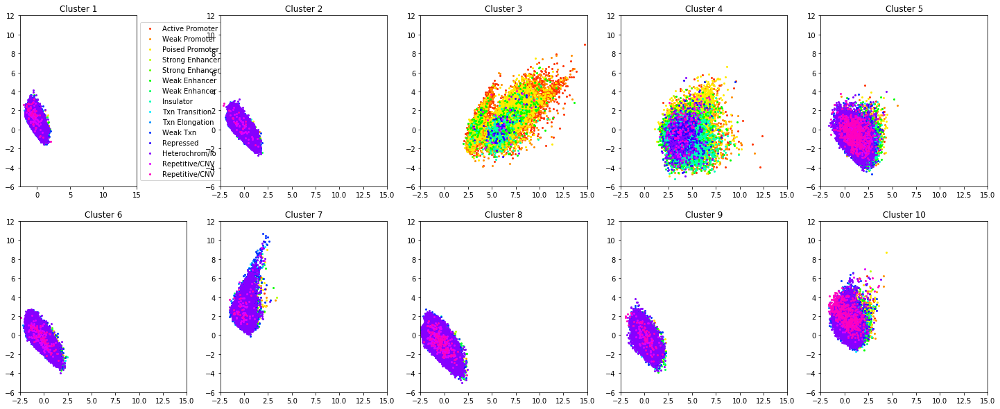

In [19]:
plot_cluster_color_by_diff_annotations(chromoHMM_labels, np.arange(NUMBER_OF_CHRMM_CLASS) + 1, ChrmoHMM_LABELS, "ChromoHMM")

In [20]:
ANNOTATION_DATA_DIR = os.path.join(K_Cluster_dir, "ANNOTATION_DATA")

In [21]:
dmr_labels = pd.read_csv(os.path.join(ANNOTATION_DATA_DIR,"DMR", "DMR_Labeled.tsv"), sep='\t', header=None).values[:, -1]

Region: DMR Annotation: DMR


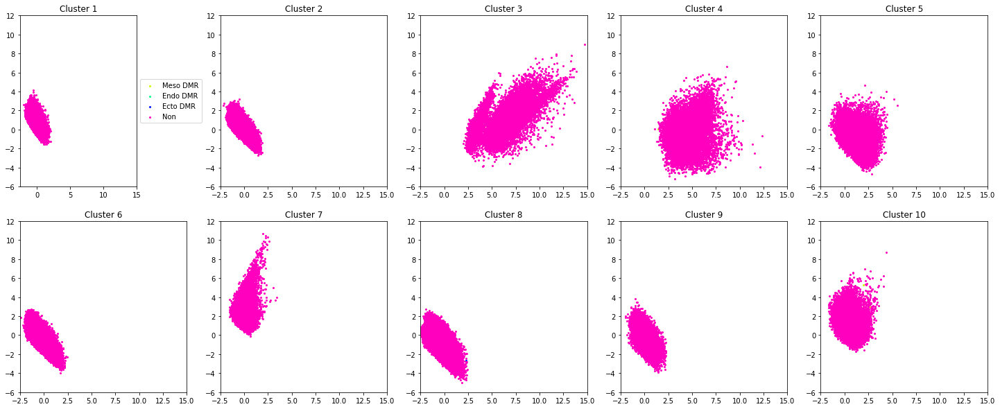

In [22]:
dmr_labels = dmr_labels + 4
plot_cluster_color_by_diff_annotations(dmr_labels, [1, 2, 3, 4], ['Meso DMR', 'Endo DMR', 'Ecto DMR', 'Non'], "DMR", "DMR")

Region: ADDED Annotation: CHD2
Region: ADDED Annotation: CTCF
Region: ADDED Annotation: P300
Region: ADDED Annotation: SUZ12
Region: ADDED Annotation: CHD1
Region: ADDED Annotation: CEBPB
Region: ADDED Annotation: RBBP5
Region: ADDED Annotation: NANOG
Region: ADDED Annotation: POL2
Region: ADDED Annotation: CMYC
Region: ADDED Annotation: SP2
Region: ADDED Annotation: TBP
Region: ADDED Annotation: EZH2
Region: ADDED Annotation: SP1
Region: ADDED Annotation: DNase
Region: ADDED Annotation: BCL11A
Region: ADDED Annotation: POU5F1
Region: ADDED Annotation: TAF1
Region: ADDED Annotation: SP4
Region: ADDED Annotation: ATF2
Region: ADDED Annotation: SIX5
Region: General Annotation: CTCF
Region: General Annotation: P300
Region: General Annotation: H2AZ
Region: General Annotation: EZH2
Region: General Annotation: DNase
Region: Genomic_Regions Annotation: LTR
Region: Genomic_Regions Annotation: Intron
Region: Genomic_Regions Annotation: CGI
Region: Genomic_Regions Annotation: Intergenic
Region: 

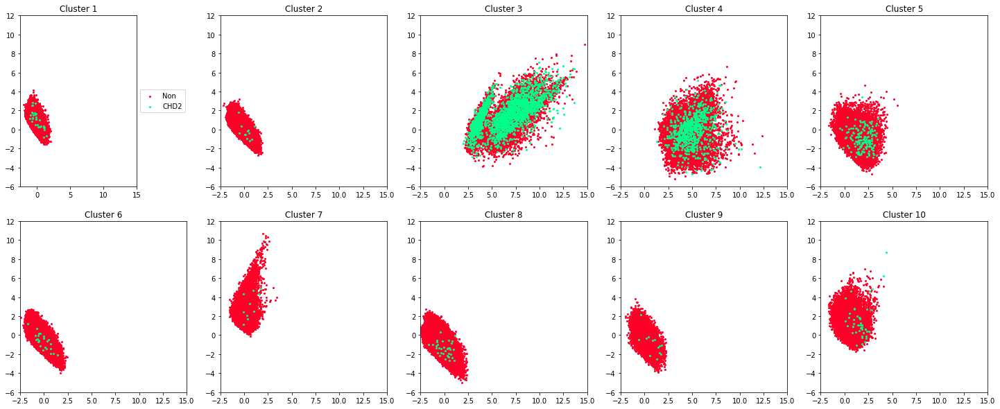

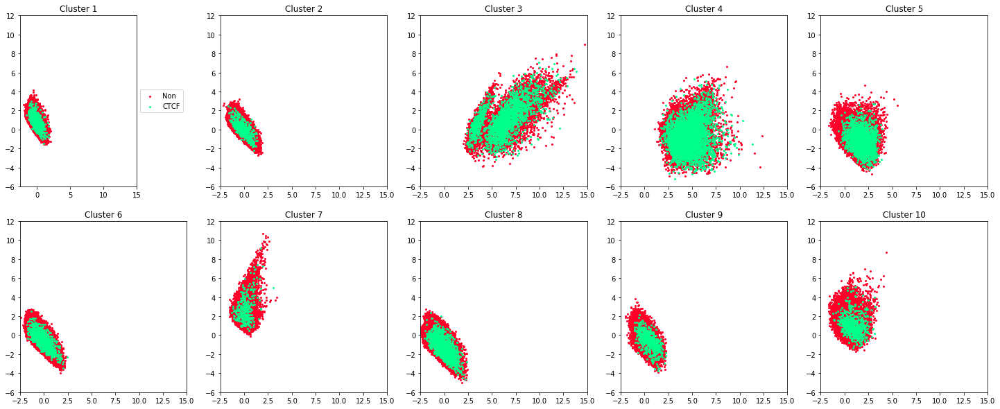

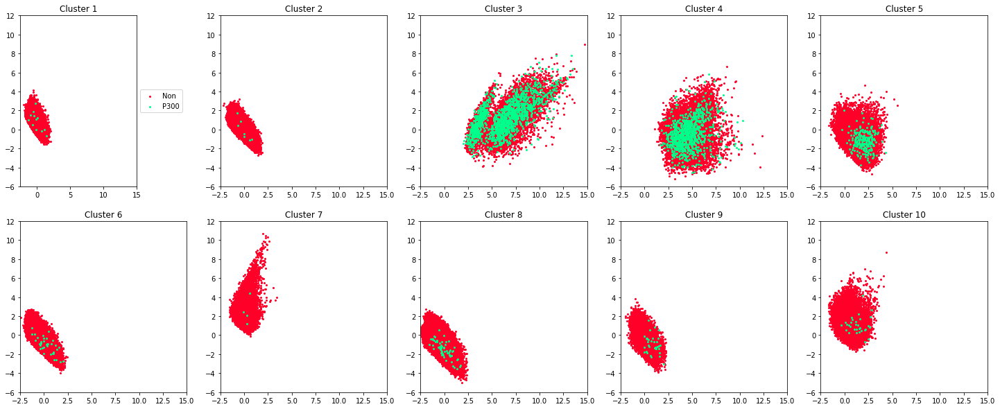

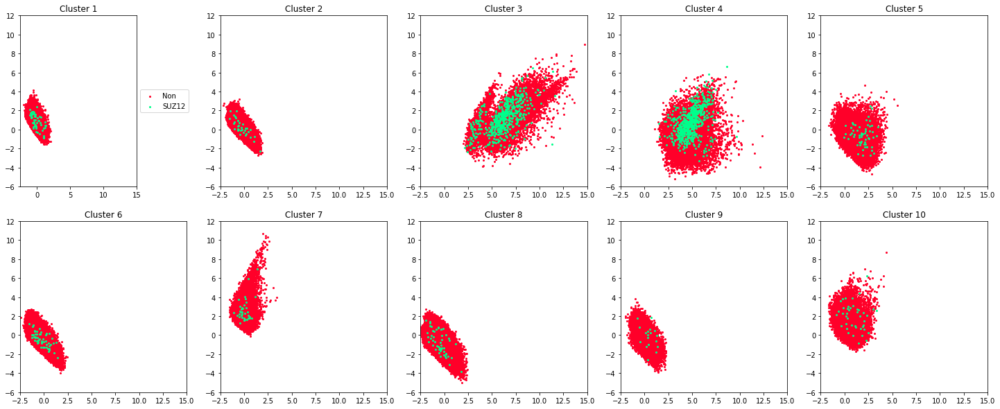

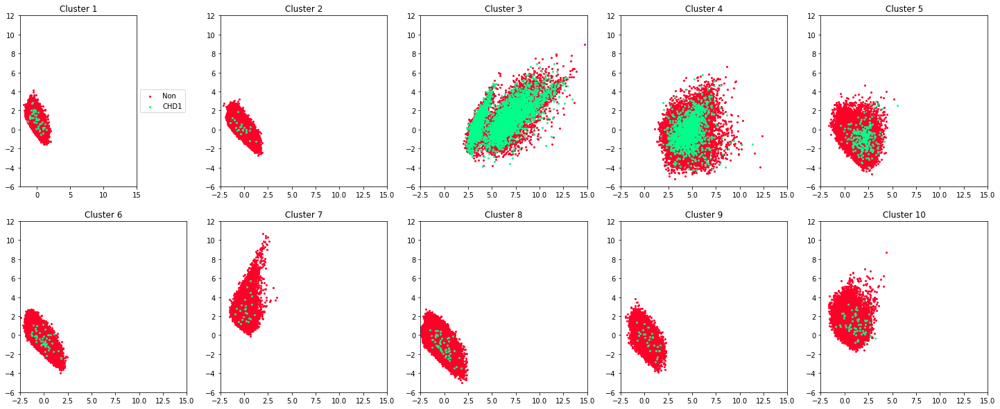

...

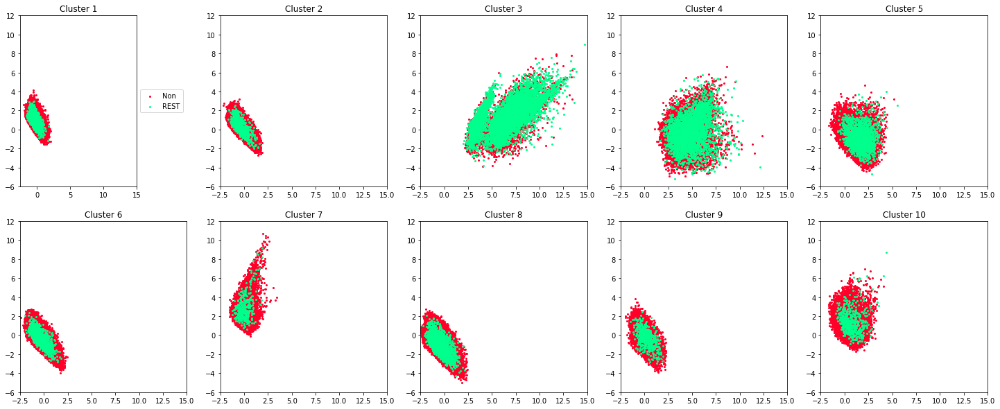

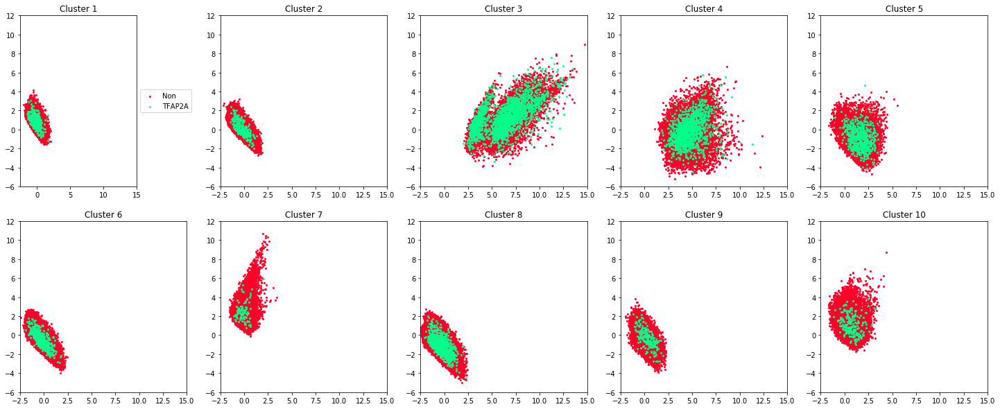

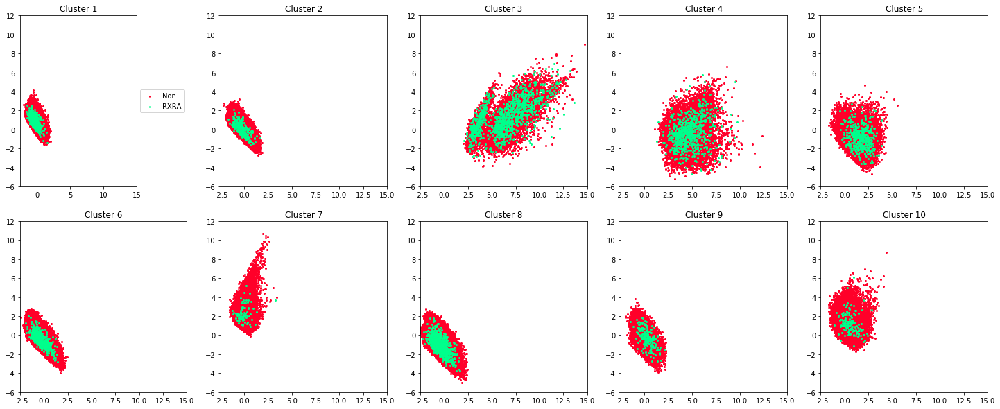

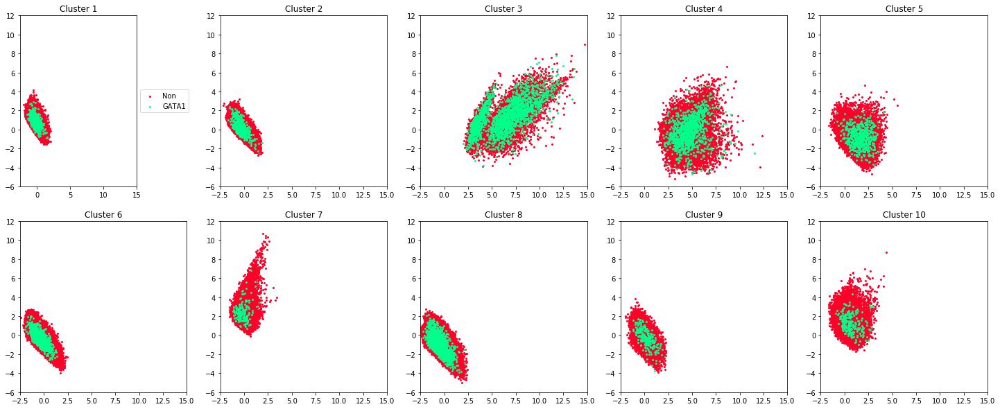

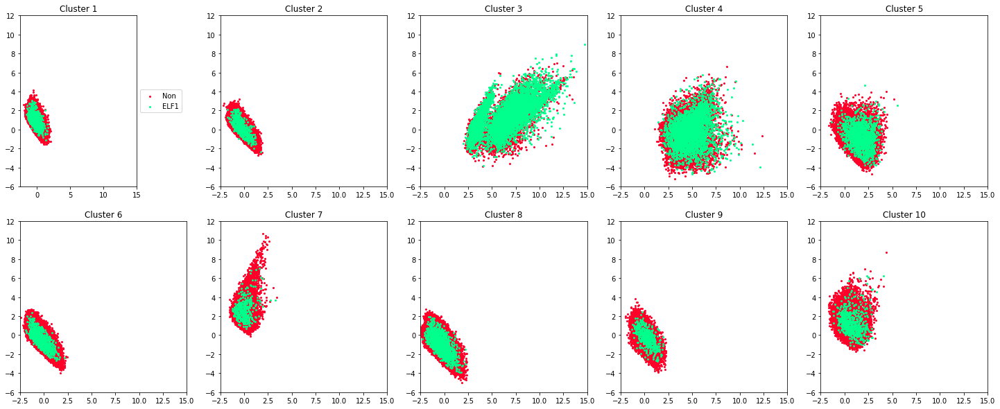

In [23]:
regions = ["ADDED","General", "Genomic_Regions", "Histone_Modification", "Histone_Modification_Enzyme","TFBS"]
for REGION in regions:
    REGION_DIR = os.path.join(ANNOTATION_DATA_DIR, REGION)
    for file_name in os.listdir(REGION_DIR):
        if file_name.endswith(".tsv"):
            anno_name = file_name.strip(".tsv")
            data_labels = pd.read_csv(os.path.join(REGION_DIR, file_name), sep='\t', header=None).values[:, -1]
            plot_cluster_color_by_diff_annotations(data_labels, [0, 1], ["Non", anno_name], anno_name, REGION)

In [27]:
K_Cluster_dir = os.path.join(DATA_SET_DIR, "K_Cluster_Analysis")

In [41]:
def plot_ChrMM_of_Cluster(cluster_fps, CLASS_LABELS):
    fig_dir = "../FIGURES/Filtered_Feature_Analysis/ChromHMM_of_Cluster"
    mkdirs([fig_dir])
    N_FILES = len(cluster_fps)
    chrHMMs = np.arange(NUMBER_OF_CHRMM_CLASS)
    class_data = np.zeros((len(chrHMMs), N_FILES))
    for fid, cluster_fp in enumerate(cluster_fps):
        df = pd.read_csv(cluster_fp, sep='\t', header=None).values
        data_HMMs = df[:, -1].astype(int)
        unique, counts = np.unique(data_HMMs, return_counts=True)
        normed_counts = counts / float(counts.sum())
        unique_dc = dict(zip(unique, normed_counts))
        for cls in chrHMMs:
            class_data[cls][fid] = unique_dc[cls + 1]
    cm = plt.get_cmap('gist_rainbow')
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    ind = np.arange(N_FILES)
    pls = []
    for cls in chrHMMs:
        if cls == 0:
            pl = ax.bar(ind, tuple(list(class_data[cls, :])), 0.35)
        else:
            sum_prev = list(np.sum(class_data[0: cls, :], axis=0))
            pl = ax.bar(ind, tuple(list(class_data[cls, :])), 0.35, bottom=tuple(sum_prev))
        for item in pl:
            item.set_color(cm(1. * cls / NUMBER_OF_CHRMM_CLASS))
        pls.append(pl)
    ax.set_ylabel('Percentage')
    ax.set_xticks(ind)
    ax.set_xticklabels(CLASS_LABELS, fontsize=10)
    ax.set_ylim(0, 1)
    ax.set_yticks(np.arange(0.2, 1.1, 0.2))
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.7, box.height])
    ax.legend(tuple(pls), tuple(ChrmoHMM_LABELS), loc='center left', bbox_to_anchor=(1, 0.5))
    ax.set_title('ChromHMM_High_K_CV_AND_Global', fontsize=18)
    plt.savefig(os.path.join(fig_dir, "ChromHMM_High_K_CV_AND_Global.png"), dpi=200)

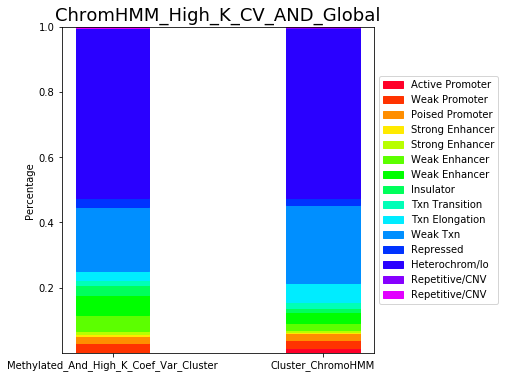

In [42]:
cluster_f1 = os.path.join(K_Cluster_dir, "Methylated_And_High_K_Coef_Var_Cluster.tsv")
cluster_f2 = os.path.join(K_Cluster_dir, "Cluster_ChromoHMM.tsv")
names = ['Methylated_And_High_K_Coef_Var_Cluster', 'Cluster_ChromoHMM']
plot_ChrMM_of_Cluster([cluster_f1, cluster_f2], names)

In [63]:
def hist_percentiles(DATA_FP, FIG_DIR, COL_INDEX, LOG_SCALE, percentiles_to_query):
    fig_dir = os.path.join(FIG_DIR, "Hist_of_Percentiles")
    mkdirs([fig_dir])
    df = pd.read_csv(DATA_FP, sep='\t', header=None).values
    ks = df[:, COL_INDEX]
    if LOG_SCALE:
        ks[ks <= 0] = 0.001
        ks = np.log10(ks)
        df[:, COL_INDEX] = ks
        percentiles = [-2.0]
    else:
        percentiles = [0.0]

    percentiles_results = list(np.percentile(ks, percentiles_to_query))
    for item in percentiles_results:
        percentiles.append(float(item))

    print(' '.join(["%.2f" % perc for perc in percentiles]))
    
    fig, ax = plt.subplots(1, 1, figsize=(8, 6))
    xhist, _, _ = ax.hist(ks, 50, density=True, facecolor='b', alpha=0.75)
    for percentile in percentiles:
        ax.axvline(x=percentile, color='r')
    if LOG_SCALE:
        xlabel = 'log10(k)'
        xlim = [-1, 1]
    else:
        xlabel = 'k'
        xlim = [0, 10]
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Probability')
    ax.set_title("Histogram of %s" % (xlabel))
    ax.set_xlim(xlim)
    plt.savefig(os.path.join(fig_dir, "Hist_of_%s.png" % (xlabel)), dpi=200)
    return percentiles

In [64]:
# Generate the percentiles

0.00 0.54 1.07 1.66 2.40 3.24 3.98 4.68 5.50 6.31 7.41 10.00


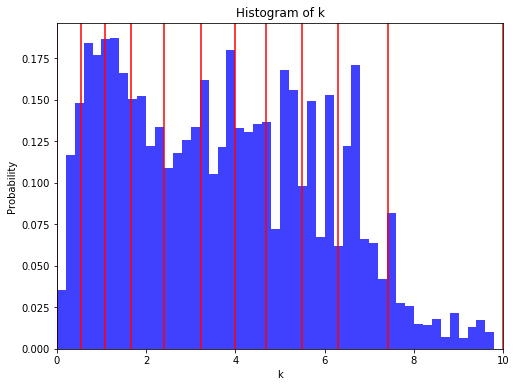

In [65]:
FIGURE_DIR = os.path.join("../FIGURES/Functional_Analysis/")
DATA_FP = os.path.join(DATA_SET_DIR, "DATA", "METHY_AND_K.tsv")
COL_INDEX = 4
LOG_SCALE = False
percentiles_to_query = [5, 15, 25, 35, 45, 55, 65, 75, 85, 95, 100]

percentiles = hist_percentiles(DATA_FP, FIGURE_DIR, COL_INDEX, LOG_SCALE, percentiles_to_query)